In [1]:
import scattertext
import os
from sklearn.feature_extraction.text import CountVectorizer
import pandas as pd

In [2]:
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

In [3]:
# prepare data
directory = 'output/unprocessed/body/'
documents = []
docdict = {}
for filename in os.listdir(directory):
    f = os.path.join(directory, filename)
    # checking if it is a file

    if (os.path.isfile(f) and (".DS_Store" not in f)):
        # print(f)
        with open(f, 'r', encoding="utf8") as fp:
            currentfiledata = fp.read()
        documents.append(currentfiledata.lower())
        fnameparts = f.split("/")
        fid = fnameparts[len(fnameparts)-1].replace(".txt","")
        docdict[fid] = currentfiledata.lower()
        
# list out keys and values separately
key_list = list(docdict.keys())
val_list = list(docdict.values())

None
water 82594
oecd 15332
management 12743
policy 9952
resources 8682
use 8571
national 8201
level 6921
governance 6903
basin 6832
public 6697
river 6341
sector 6289
countries 6184
environmental 6142
sanitation 6059
services 5994
development 5745
government 5566
quality 5553
economic 5529
risk 5484
costs 5325
groundwater 5227
supply 5123
agriculture 4929
state 4833
climate 4782
local 4663
information 4604
change 4586
10 4506
based 4381
areas 4274
infrastructure 4121
environment 4110
cost 4059
et 3882
users 3852
source 3825
financial 3755
related 3746
al 3711
pollution 3684
flood 3643
private 3639
systems 3572
new 3531
service 3530
wastewater 3526


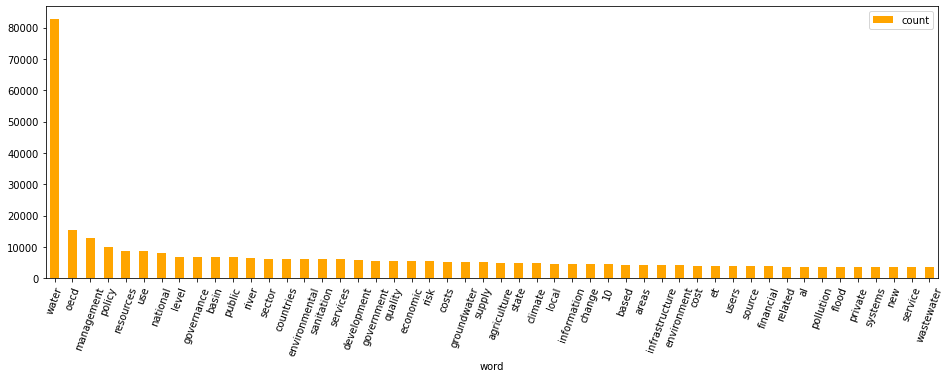

In [4]:
# Frequent words
def get_top_n_words(corpus, n=None):
    vec = CountVectorizer(stop_words = 'english').fit(corpus)
    print(vec.vocabulary)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_words(documents, 50)
for word, freq in common_words:
    print(word, freq)
    
df1 = pd.DataFrame(common_words, columns = ['word' , 'count'])
ax = df1.plot.bar(x='word', y='count', color="orange", rot=70, figsize=(16,5))

water resources 6025
water supply 3718
river basin 3658
et al 3600
climate change 3459
water governance 3387
water management 3318
water quality 3032
water sanitation 2598
drinking water 2180
water policy 2144
water use 1930
water sector 1831
stakeholder engagement 1704
org 10 1665
doi org 1664
oecd countries 1583
water related 1448
dx doi 1440
water users 1410
oecd publishing 1397
national water 1386
long term 1382
resources management 1371
http dx 1333
wastewater treatment 1321
surface water 1277
10 1787 1273
oecd 2015 1269
sanitation services 1258
decision making 1252
water charges 1251
supply sanitation 1215
publishing paris 1211
private sector 1207
water services 1181
sub national 1133
united states 1126
water resource 955
world bank 929


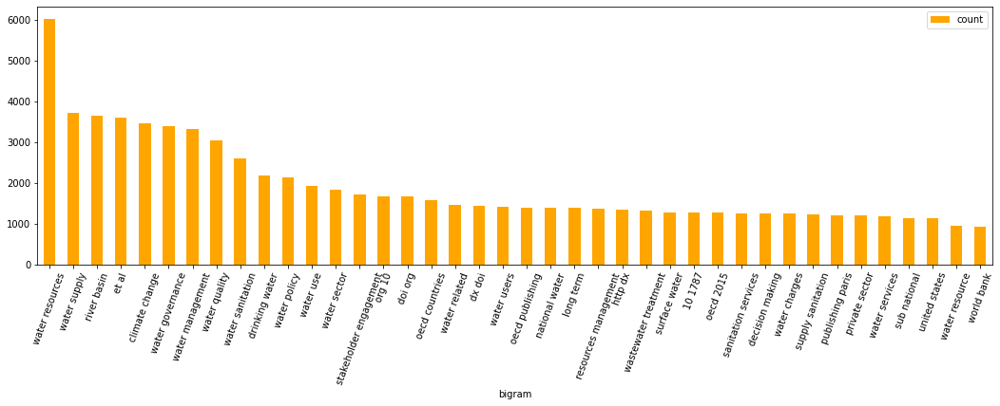

In [5]:
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2, 2), stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_bigram(documents, 40)
for word, freq in common_words:
    print(word, freq)
    
df2 = pd.DataFrame(common_words, columns = ['bigram' , 'count'])
ax2 = df2.plot.bar(x='bigram', y='count', color="orange", rot=70, figsize=(18,5))

doi org 10 1658
dx doi org 1435
http dx doi 1328
water resources management 1299
oecd publishing paris 1211
water supply sanitation 1202
org 10 1787 1186
water sanitation services 734
paris http dx 699
publishing paris http 696
www oecd org 628
water resources governance 531
river basin committees 531
private sector participation 525
resources governance brazil 511
governance brazil oecd 496
water resource management 486
brazil oecd 2015 468
oecd studies water 449
water framework directive 442
water oecd publishing 441
studies water oecd 438
water governance oecd 435
regional water authorities 424
river basin management 423
oecd principles water 422
sub national level 403
principles water governance 402
multi level governance 340
river basin organisations 335
stakeholder engagement inclusive 329
inclusive water governance 329
et al 2012 326
climate change adaptation 322
engagement inclusive water 319
water governance netherlands 319
governance netherlands fit 311
netherlands fit future

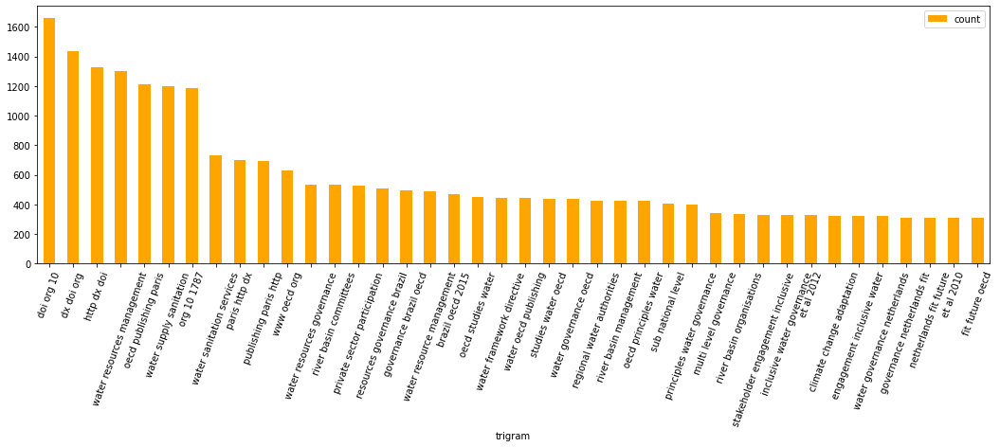

In [6]:
def get_top_n_trigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3, 3), stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_trigram(documents, 40)

for word, freq in common_words:
    print(word, freq)
    
df3 = pd.DataFrame(common_words, columns = ['trigram' , 'count'])
ax3 = df3.plot.bar(x='trigram', y='count', color="orange", rot=70, figsize=(18,5))

dx doi org 10 1429
http dx doi org 1323
doi org 10 1787 1180
water supply and sanitation 1124
water and sanitation services 726
in the water sector 702
oecd publishing paris http 696
paris http dx doi 694
publishing paris http dx 691
in the case of 525
water resources governance in 515
resources governance in brazil 511
governance in brazil oecd 495
in brazil oecd 2015 467
oecd studies on water 449
studies on water oecd 438
on water oecd publishing 436
water oecd publishing paris 423
oecd principles on water 415
principles on water governance 399
the implementation of the 393
of water and sanitation 376
as well as the 372
in the context of 354
for water supply and 354
water governance in the 348
fit for the future 325
stakeholder engagement for inclusive 321
governance in the netherlands 320
engagement for inclusive water 316


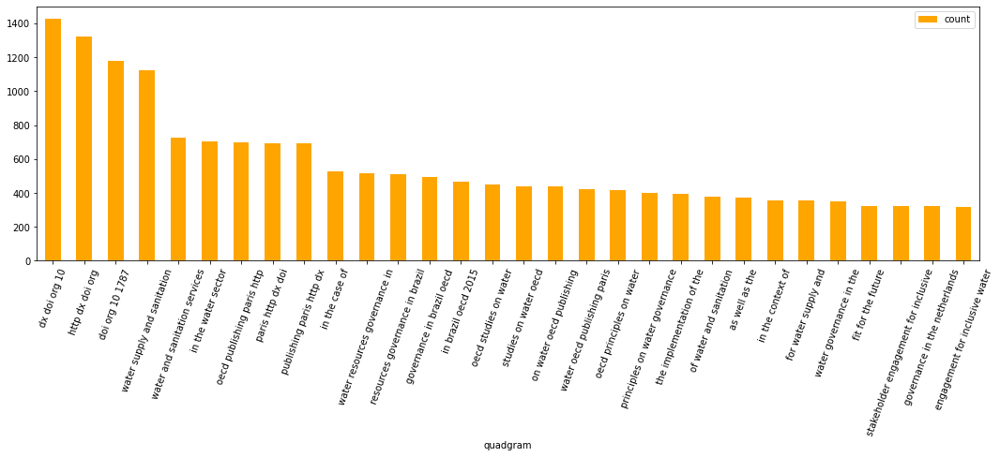

In [7]:
# no stopwords removed here for quadgrams
def get_top_n_quadgram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(4, 4)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_quadgram(documents, 30)

for word, freq in common_words:
    print(word, freq)
    
df4 = pd.DataFrame(common_words, columns = ['quadgram' , 'count'])
ax4 = df4.plot.bar(x='quadgram', y='count', color="orange", rot=70, figsize=(18,5))

Document number:  29



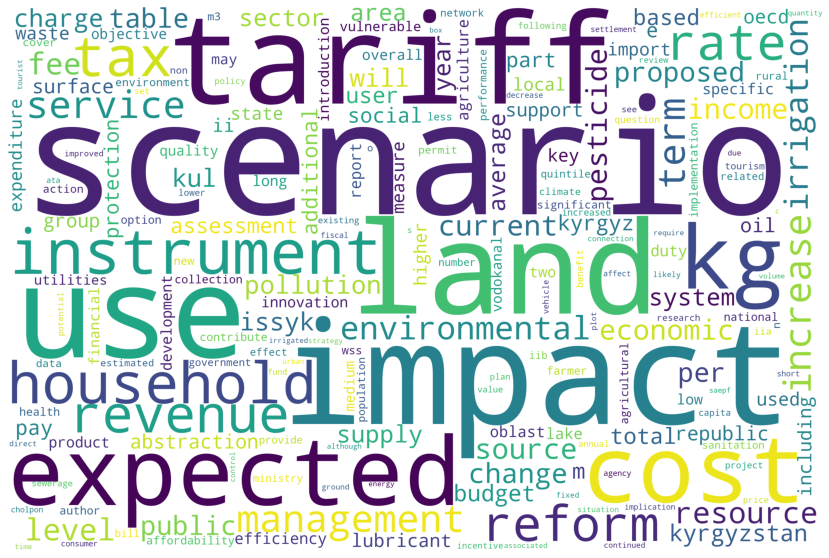


Document number:  15



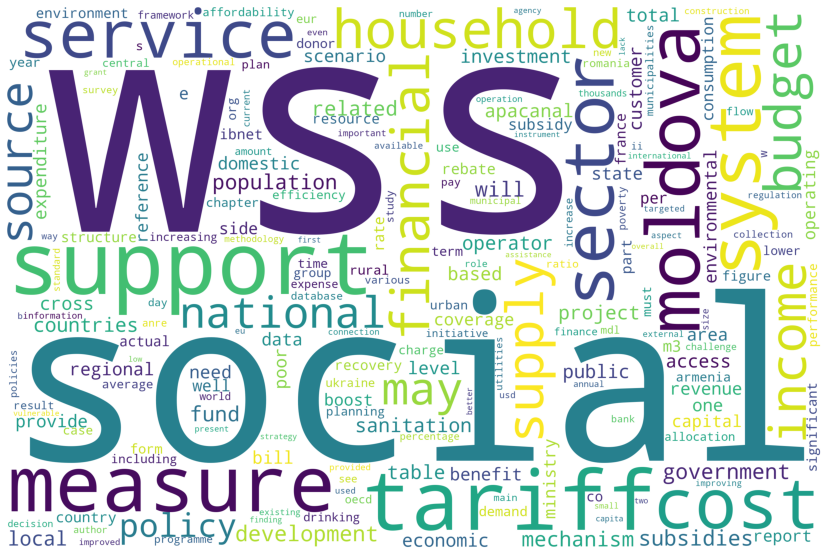


Document number:  14



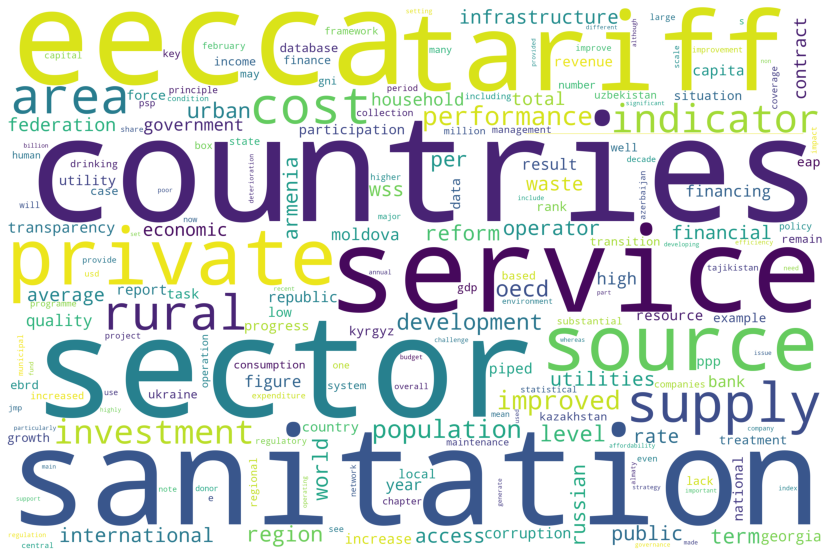


Document number:  28



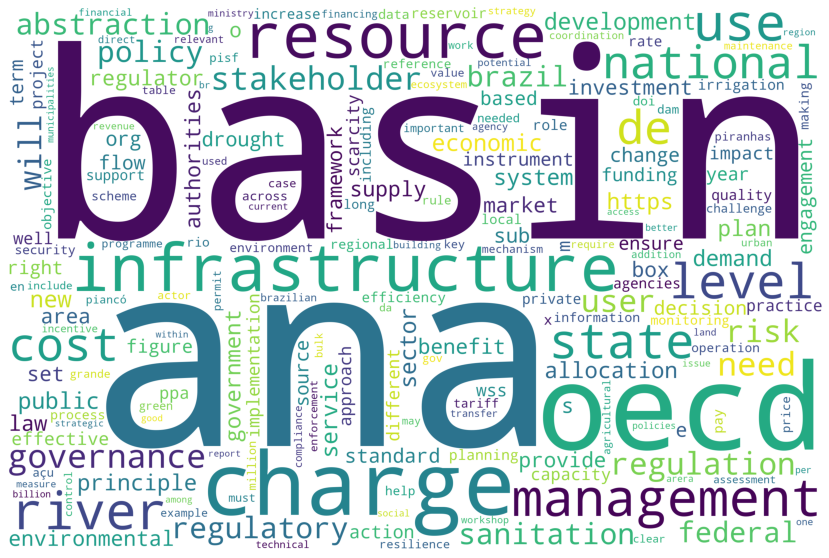


Document number:  16



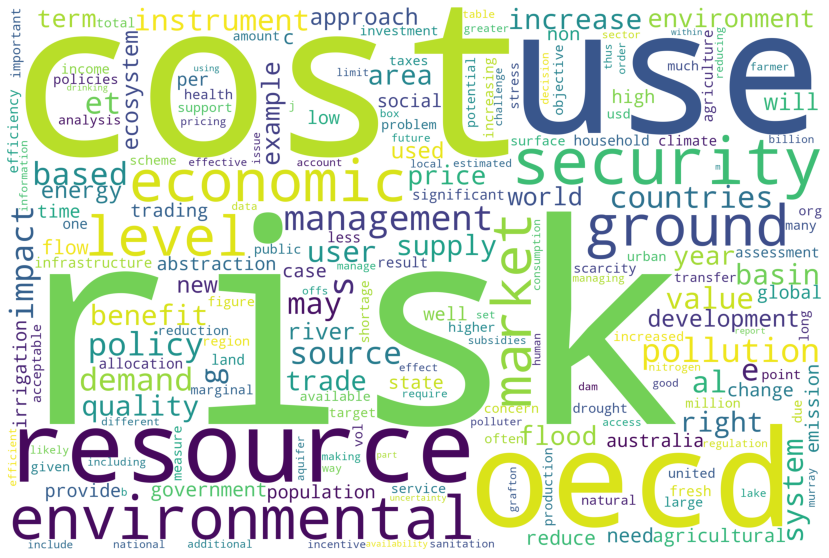


Document number:  17



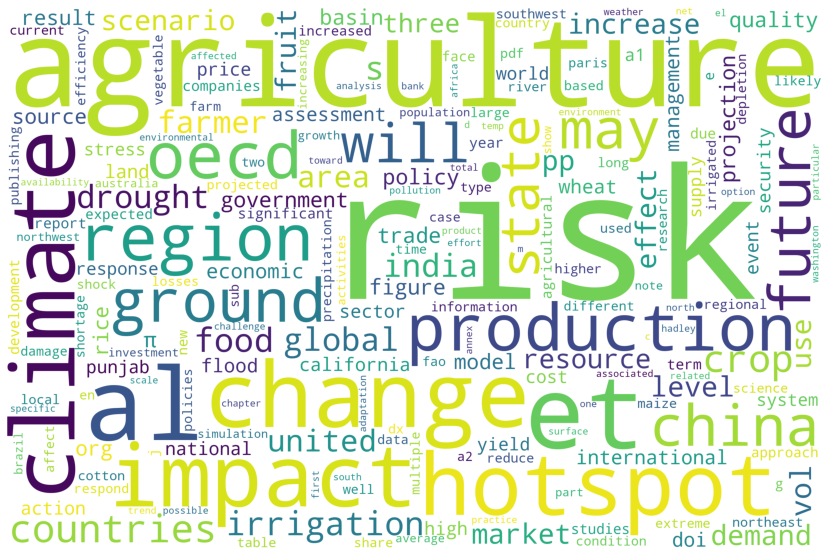


Document number:  13



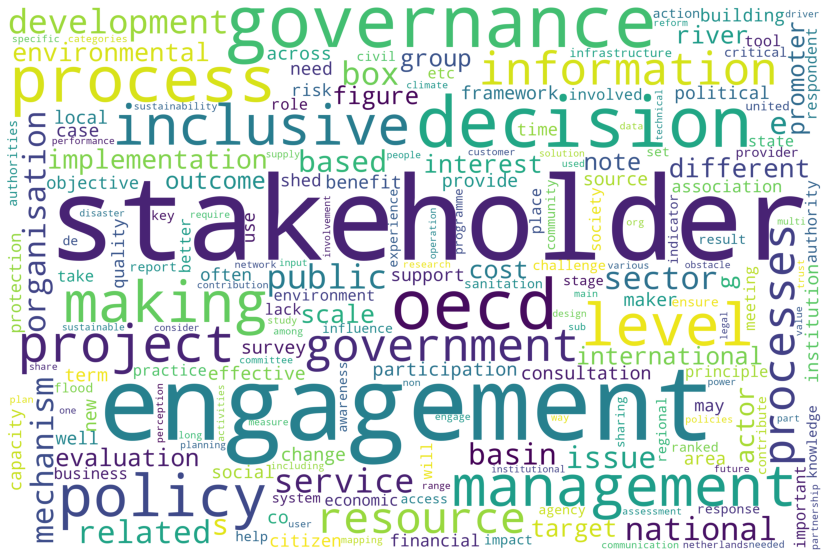


Document number:  12



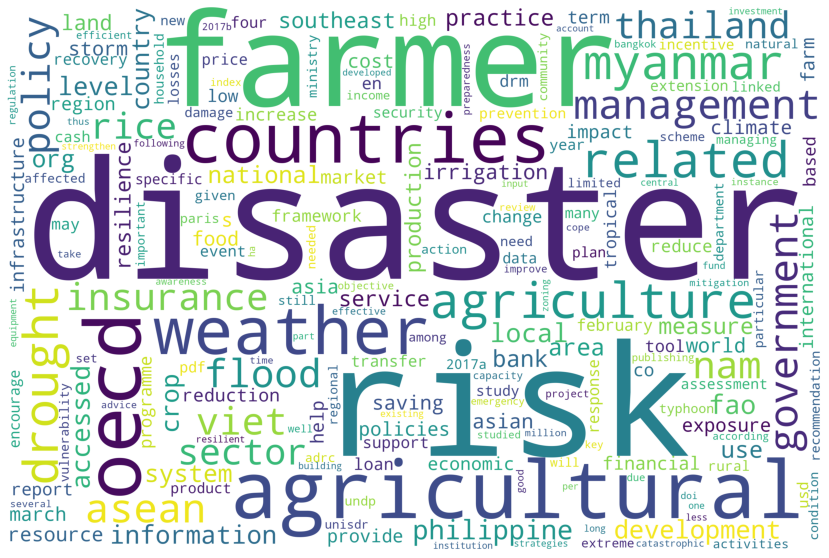


Document number:  10



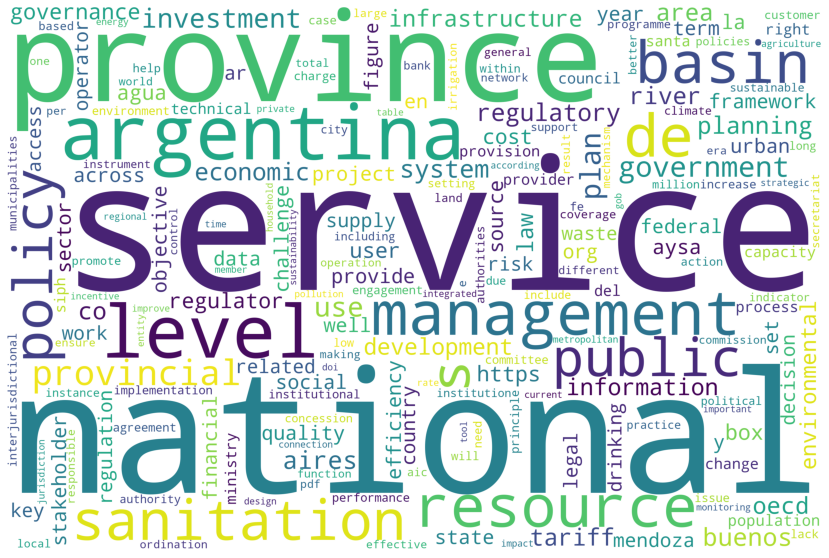


Document number:  38



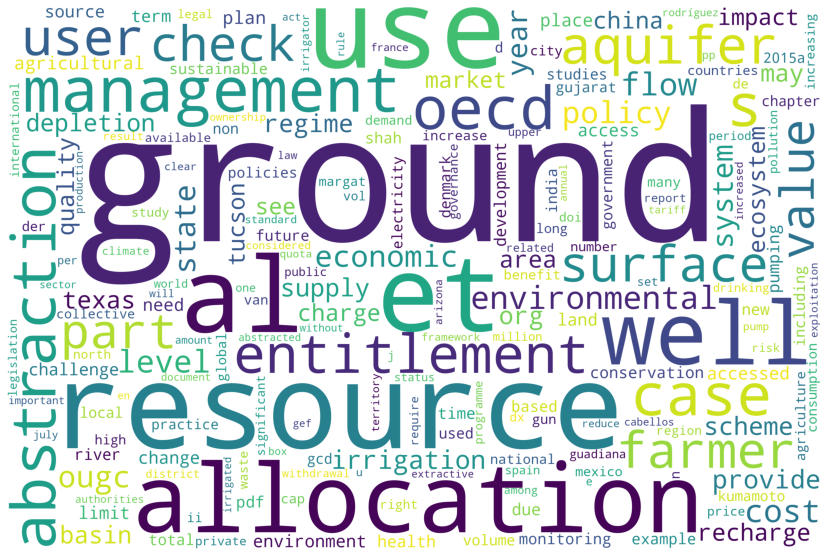


Document number:  39



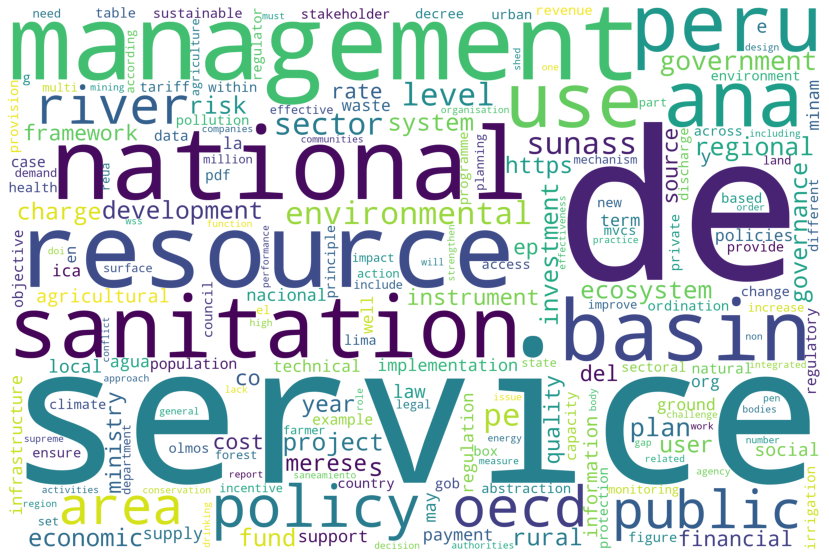


Document number:  11



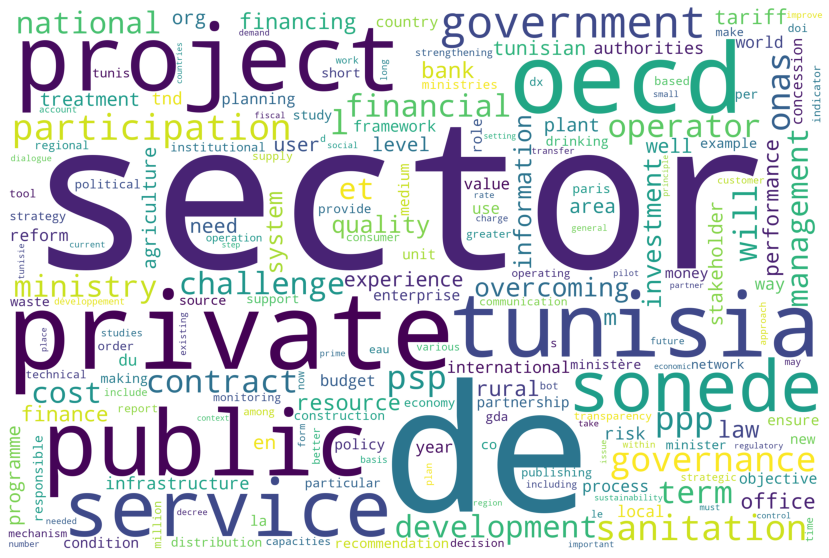


Document number:  49



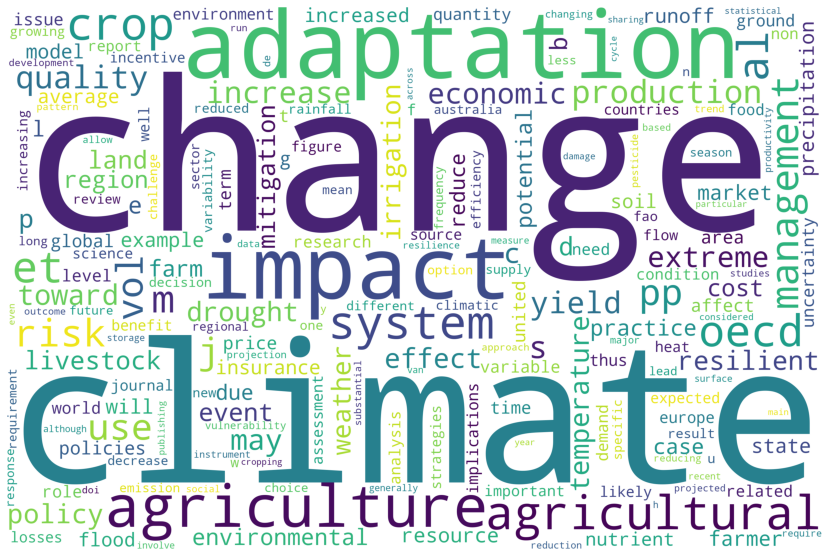


Document number:  48



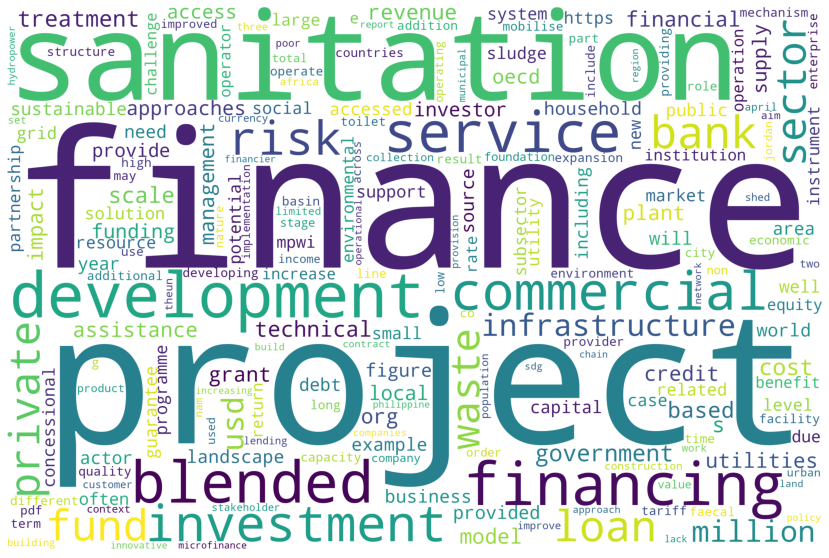


Document number:  9



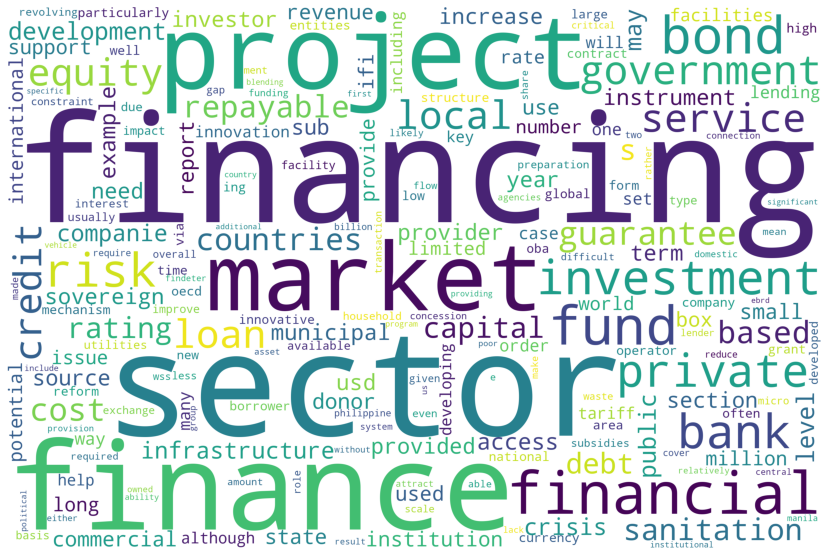


Document number:  5



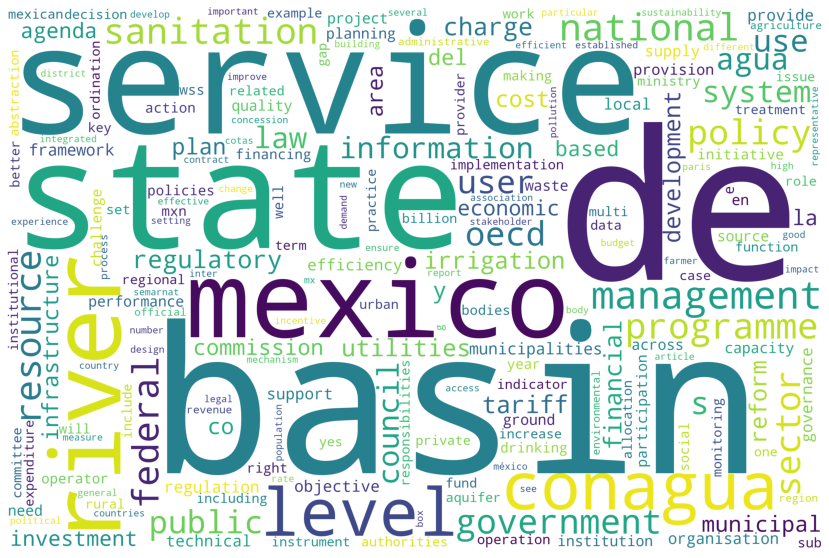


Document number:  43



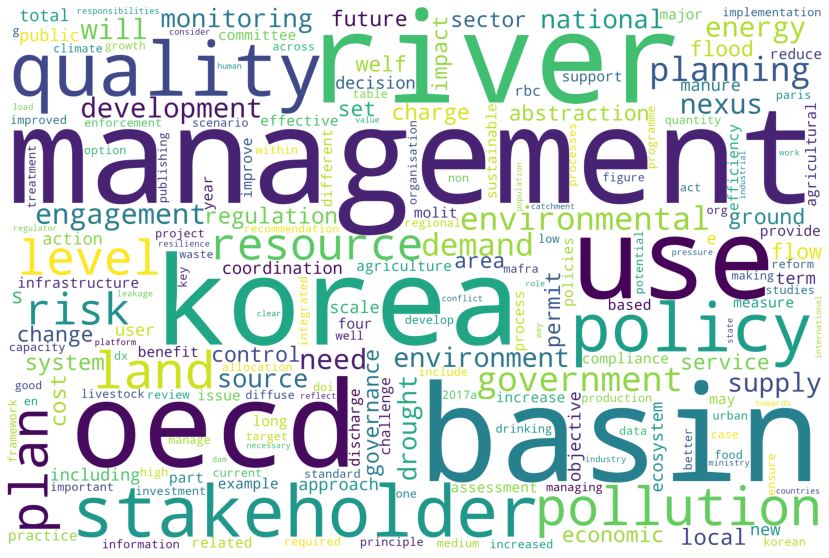


Document number:  42



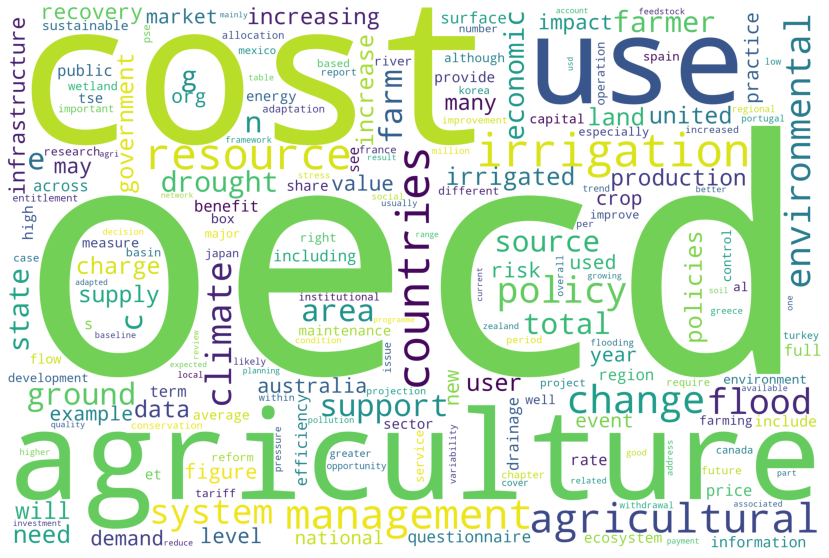


Document number:  4



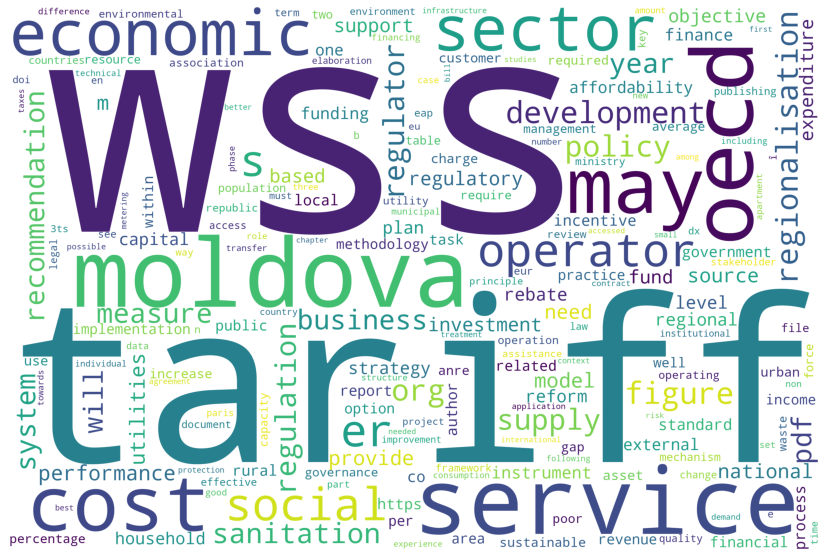


Document number:  40



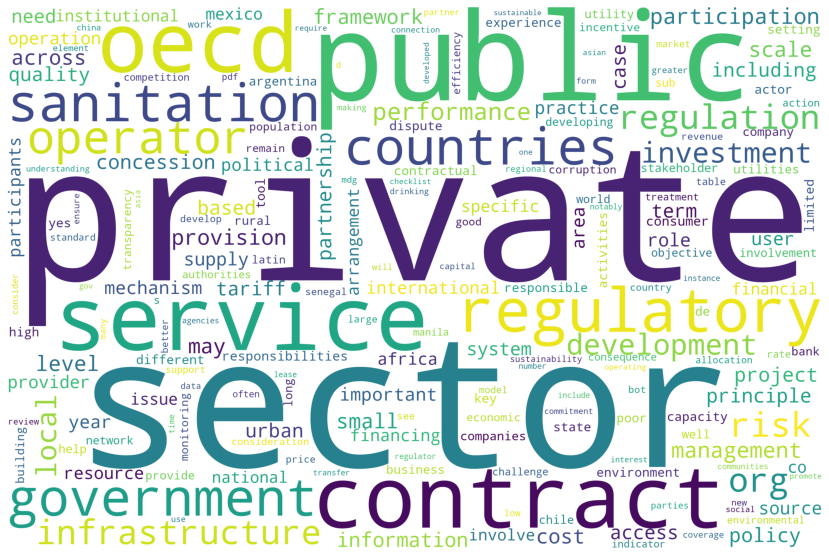


Document number:  6



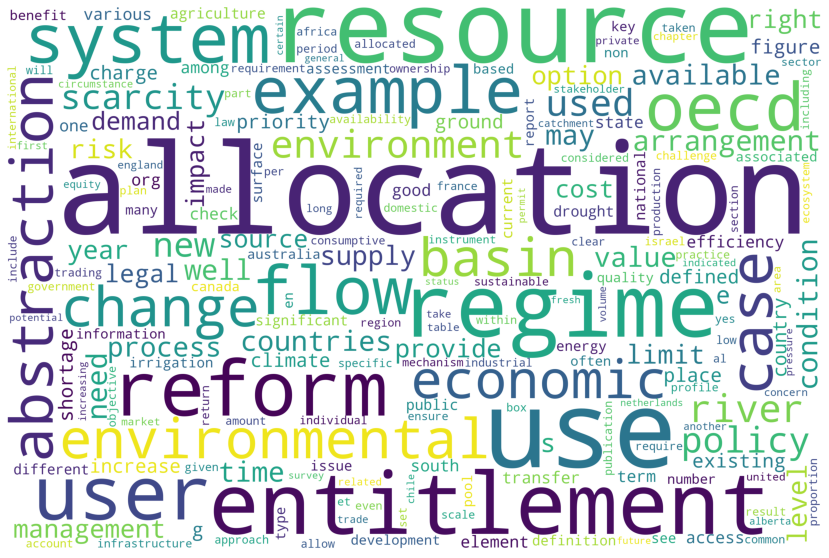


Document number:  54



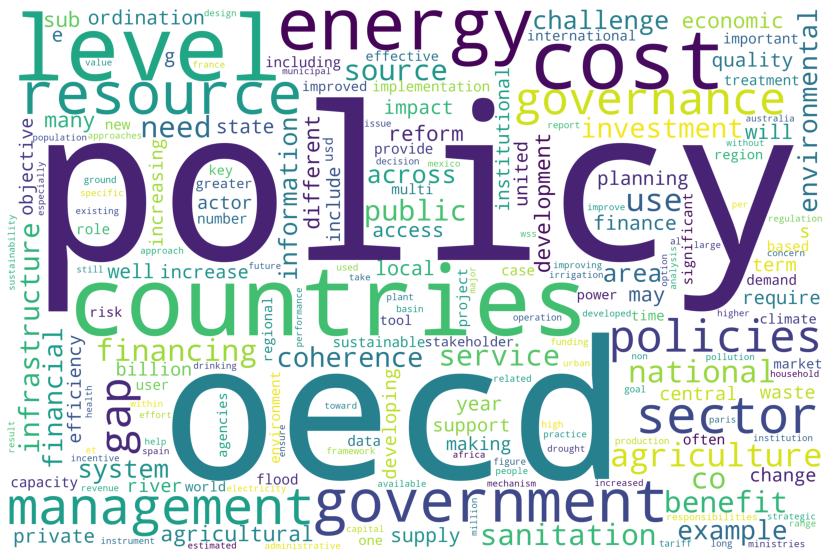


Document number:  7



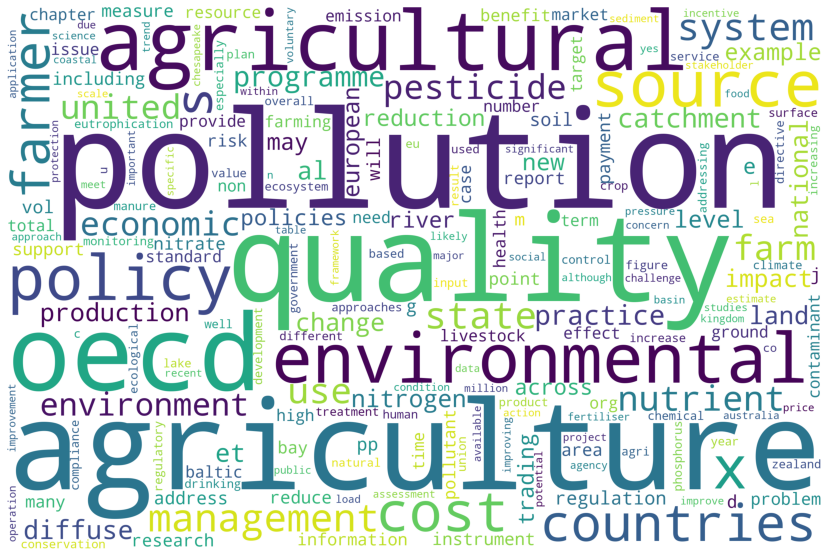


Document number:  55



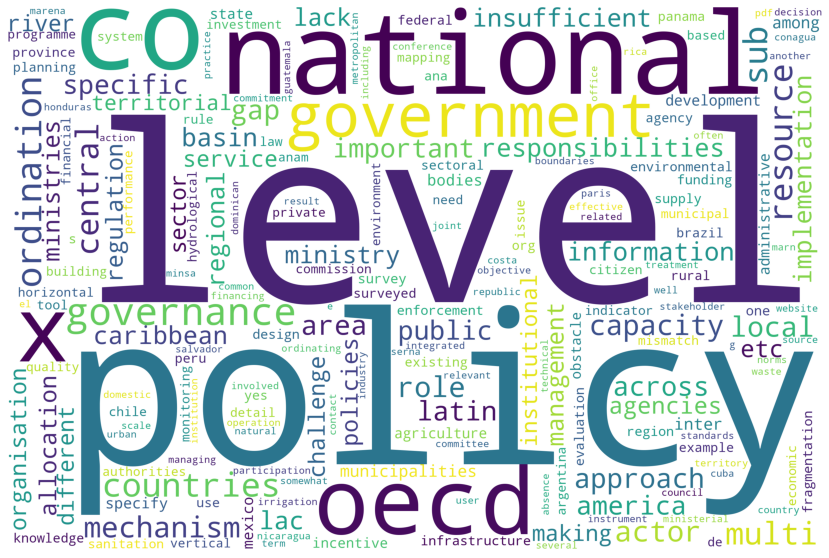


Document number:  41



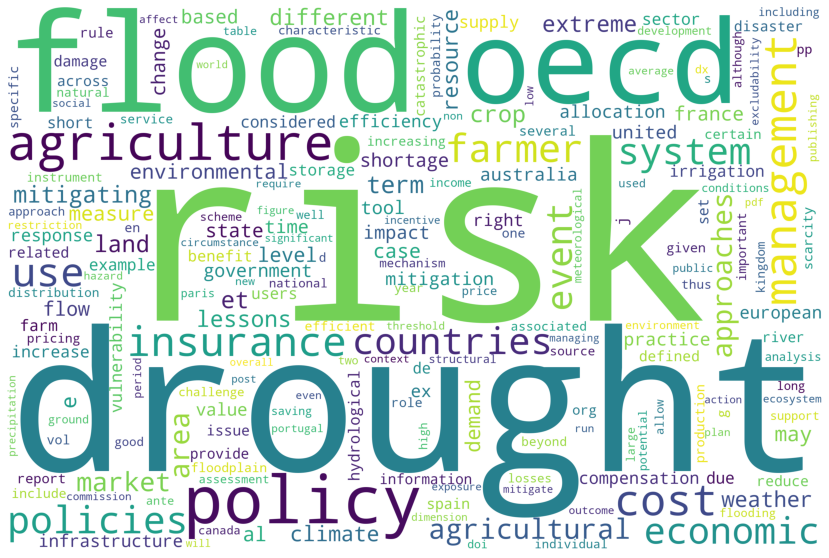


Document number:  45



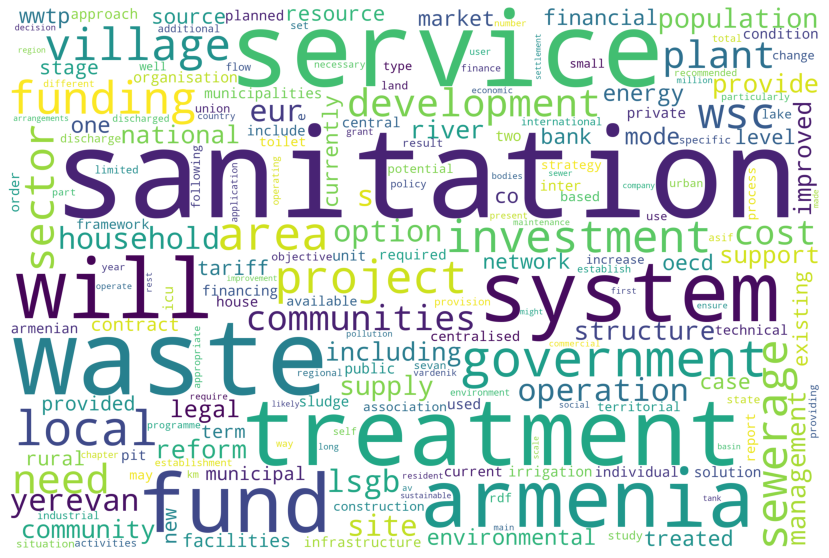


Document number:  51



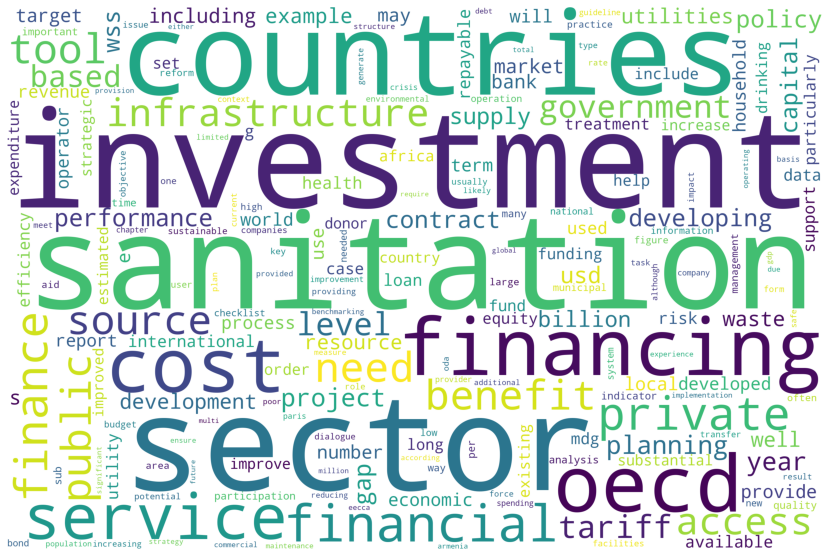


Document number:  3



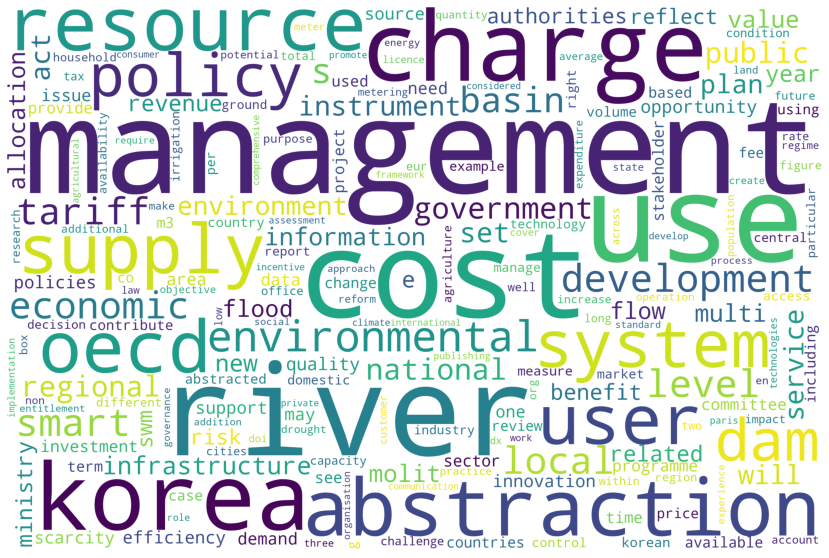


Document number:  50



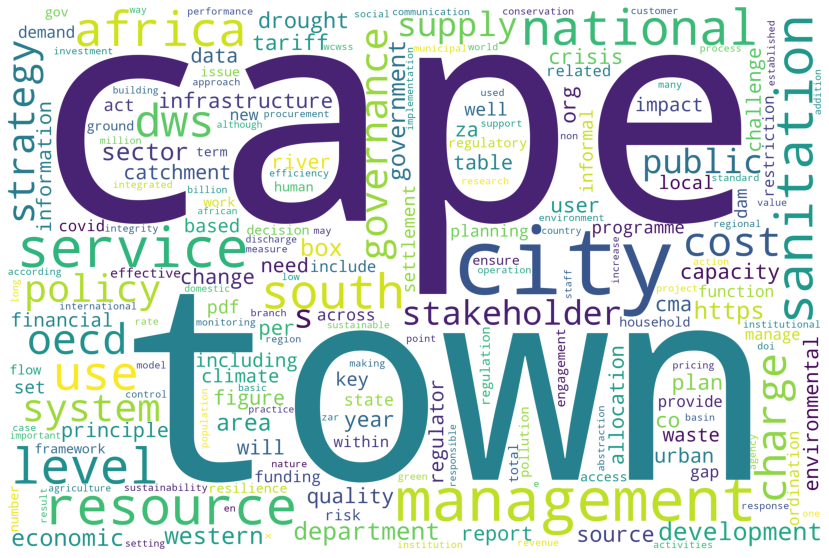


Document number:  2



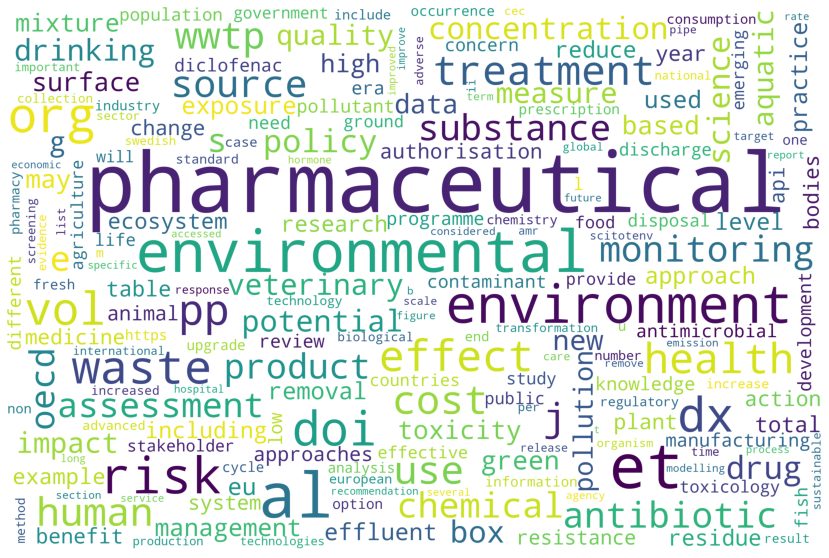


Document number:  44



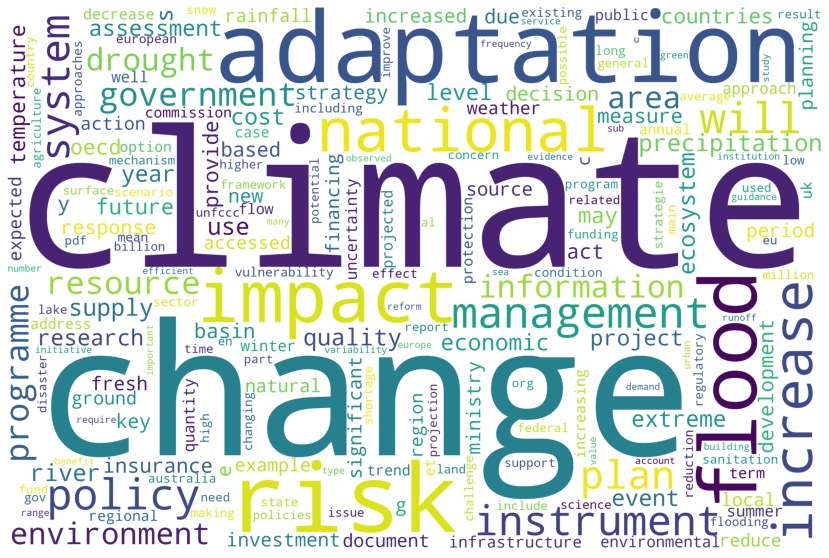


Document number:  0



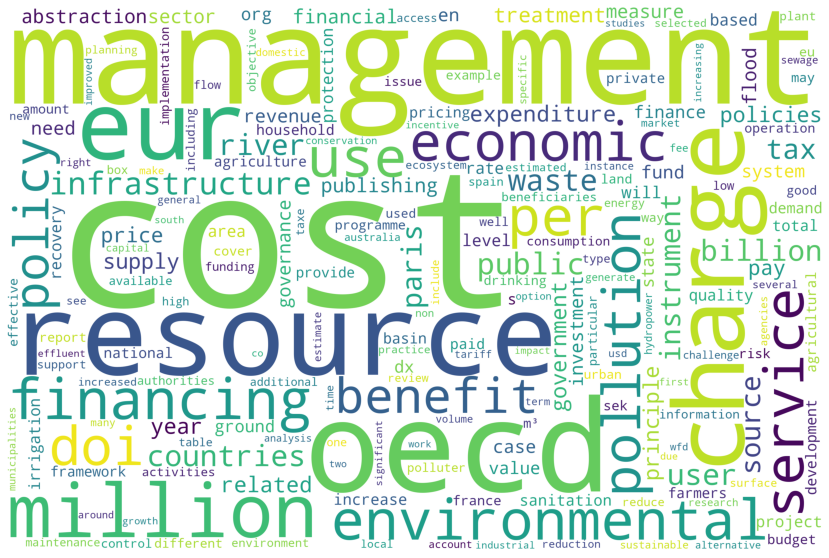


Document number:  52



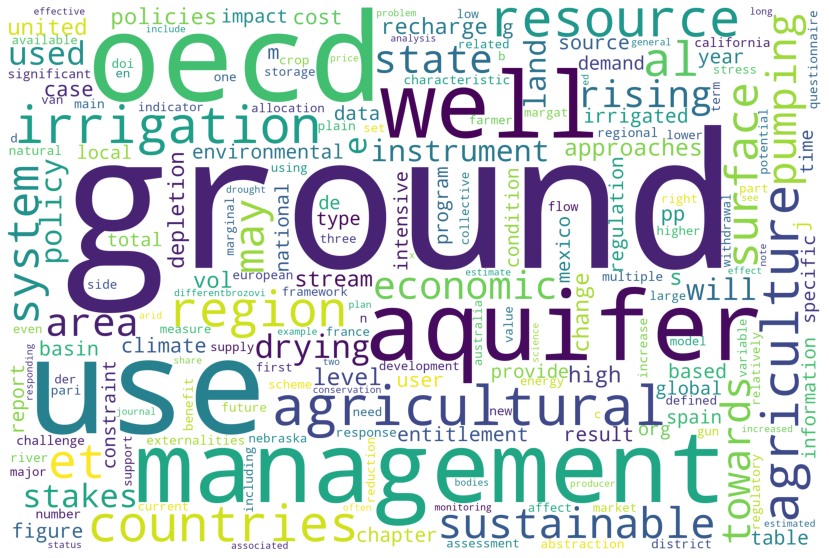


Document number:  46



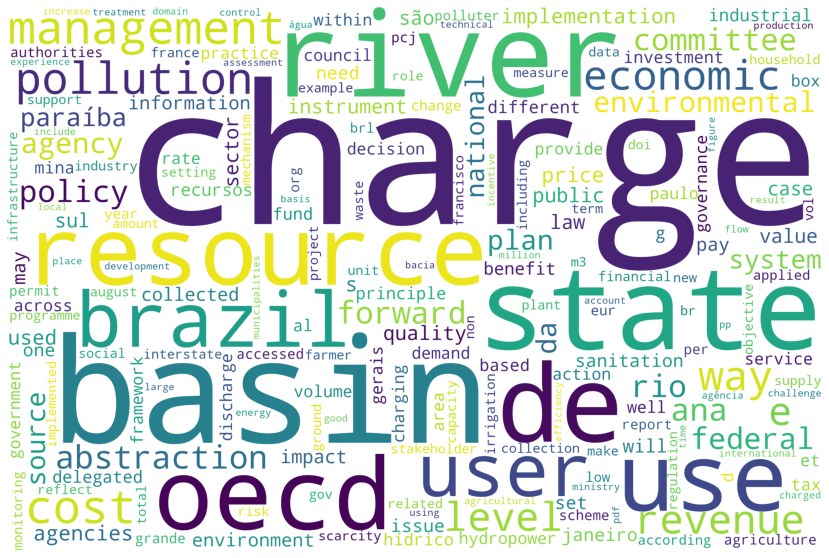


Document number:  47



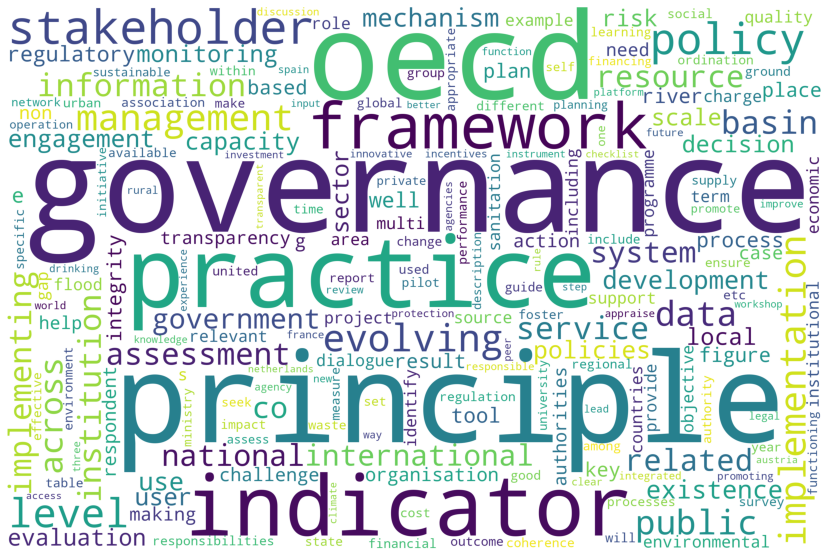


Document number:  1



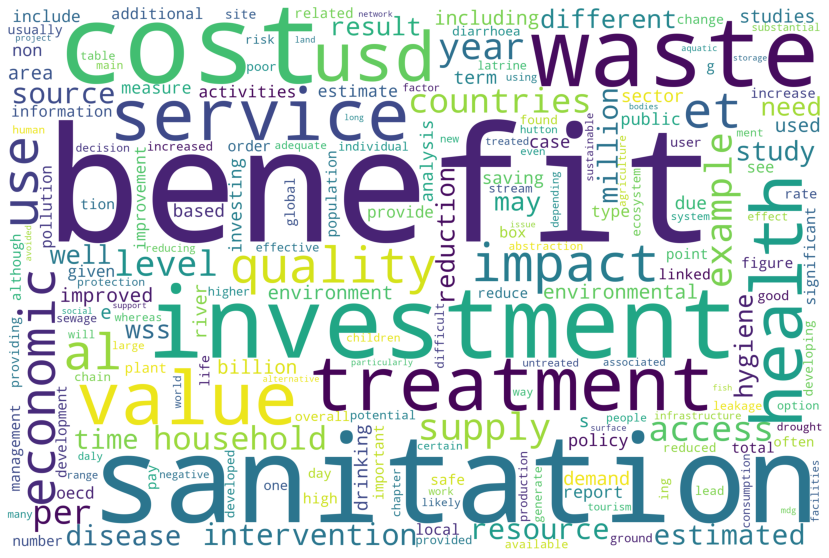


Document number:  53



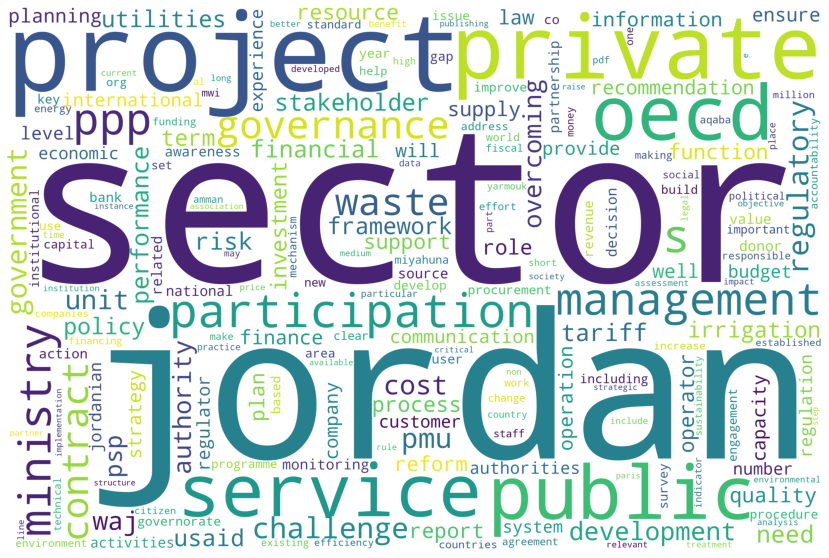


Document number:  34



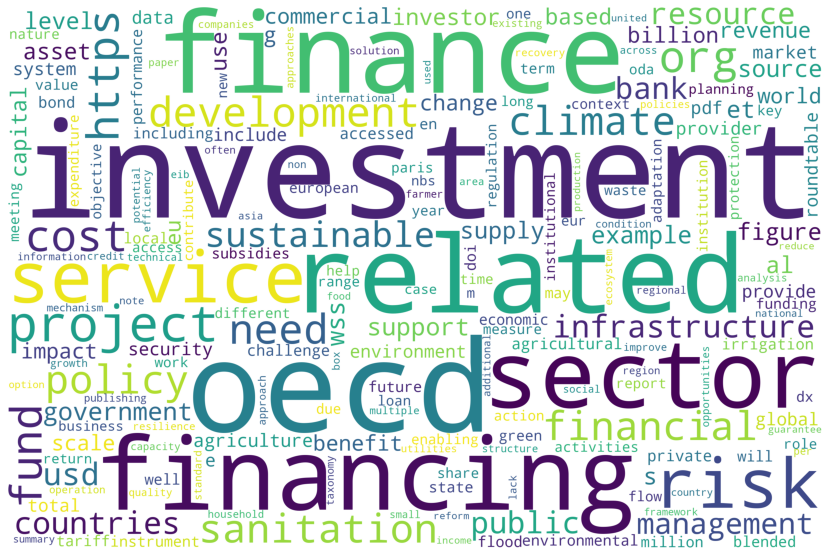


Document number:  20



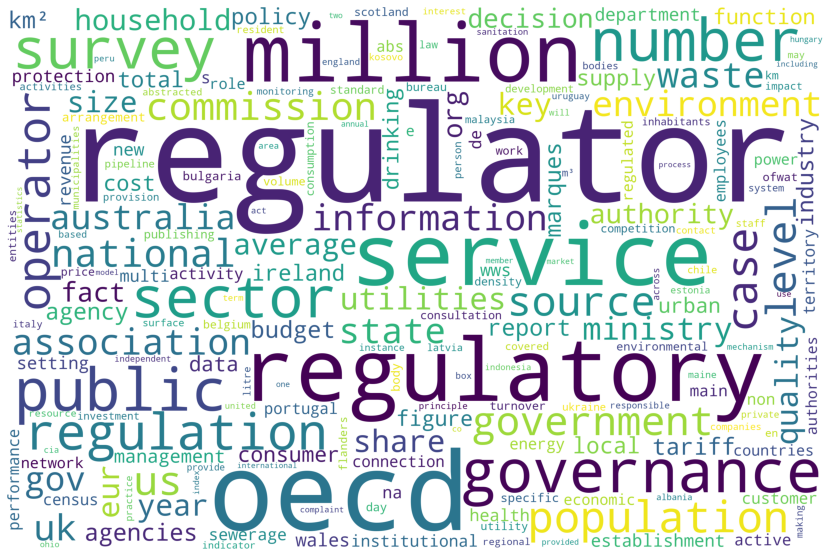


Document number:  35



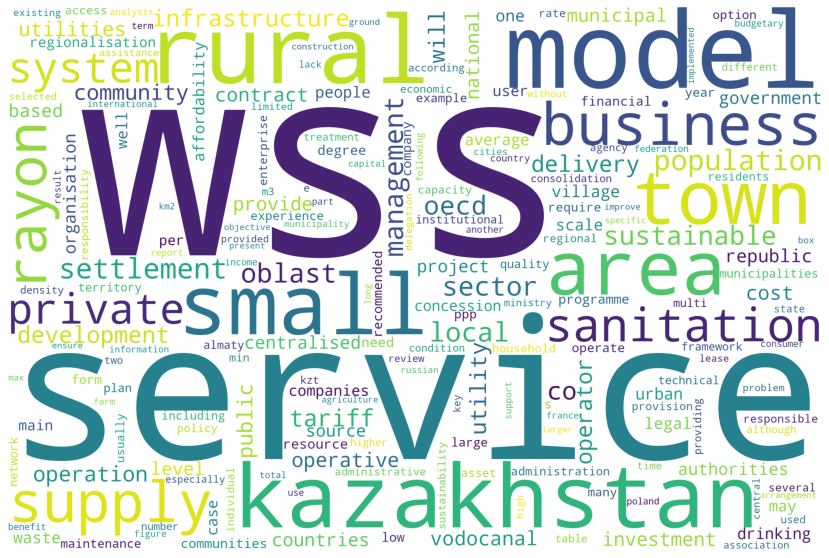


Document number:  23



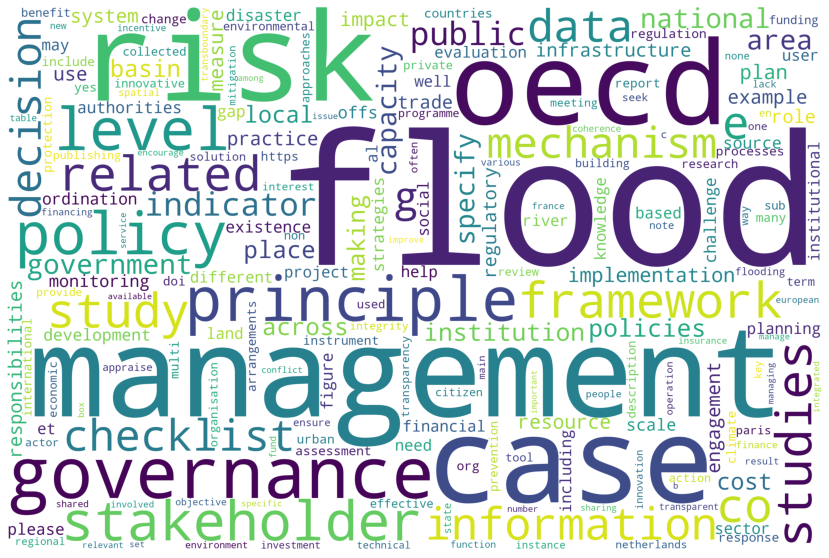


Document number:  37



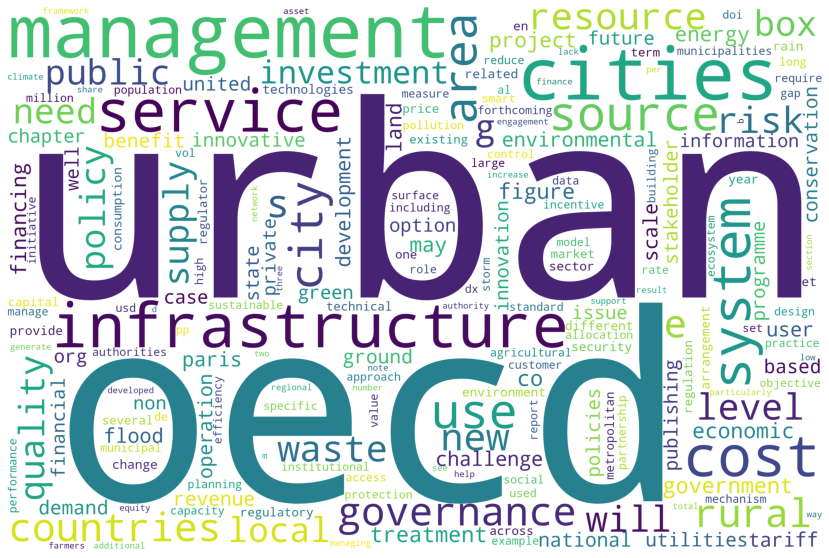


Document number:  36



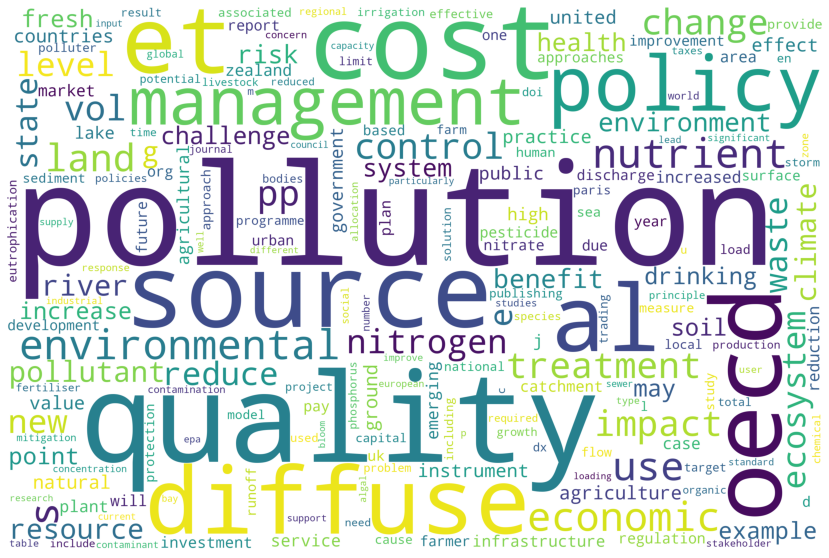


Document number:  22



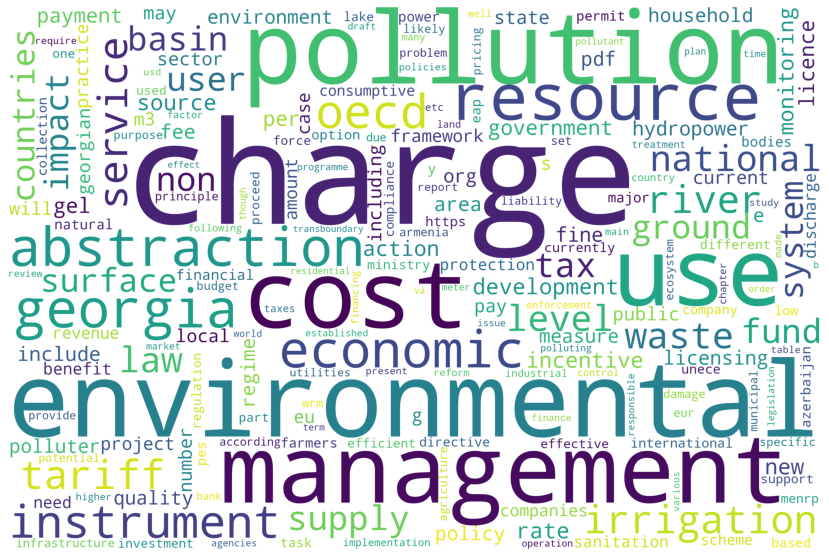


Document number:  26



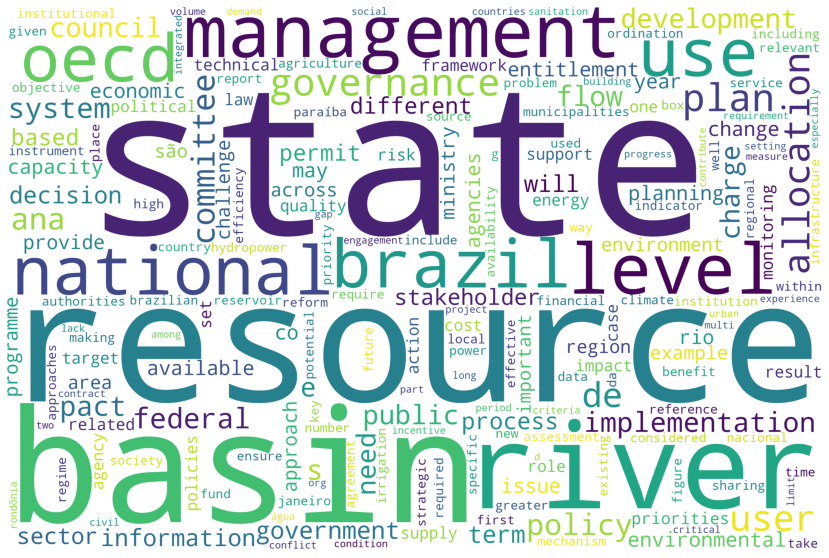


Document number:  32



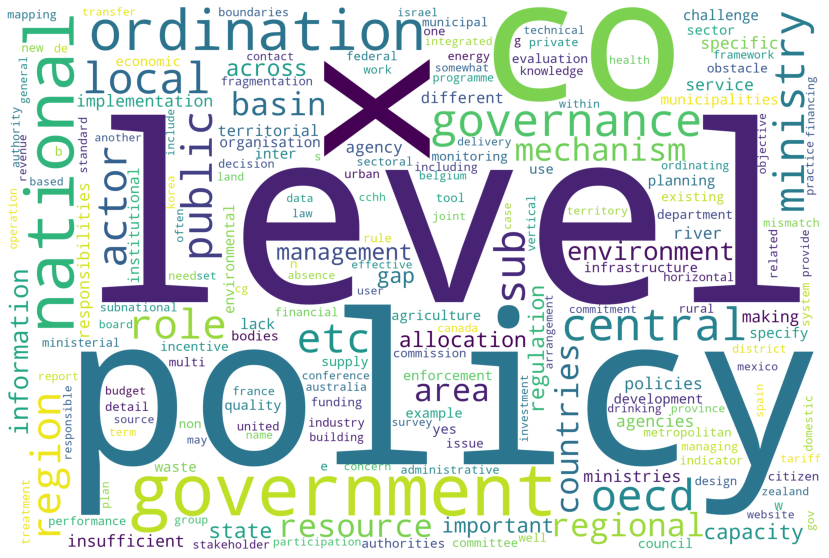


Document number:  33



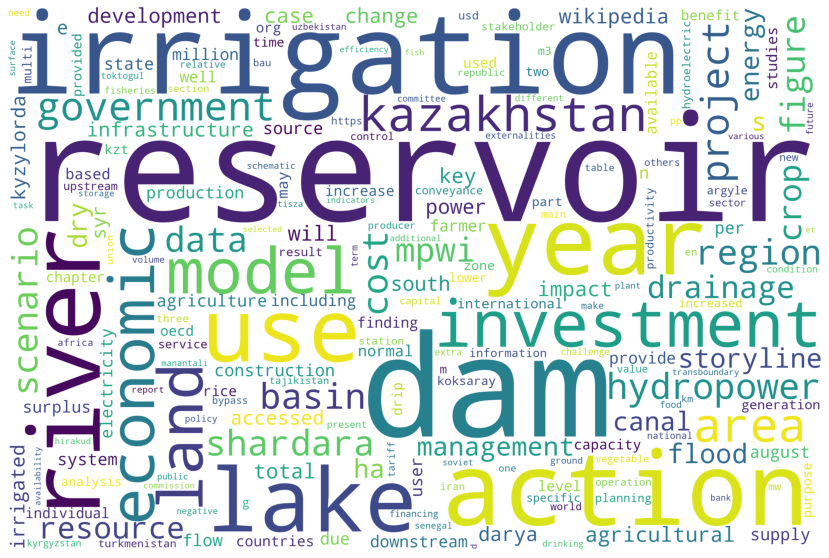


Document number:  27



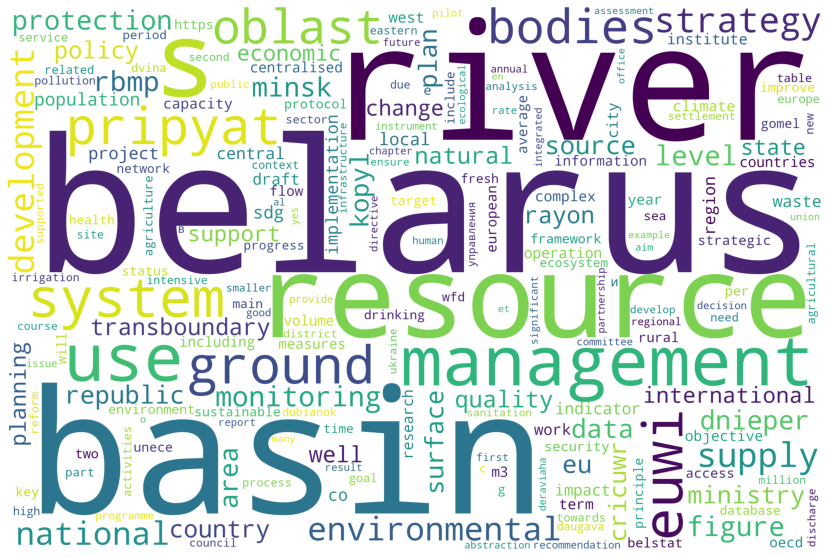


Document number:  31



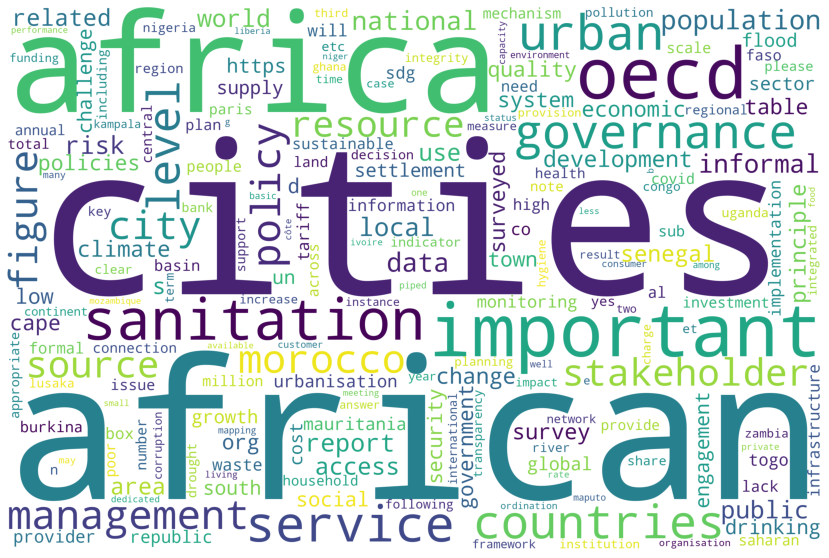


Document number:  25



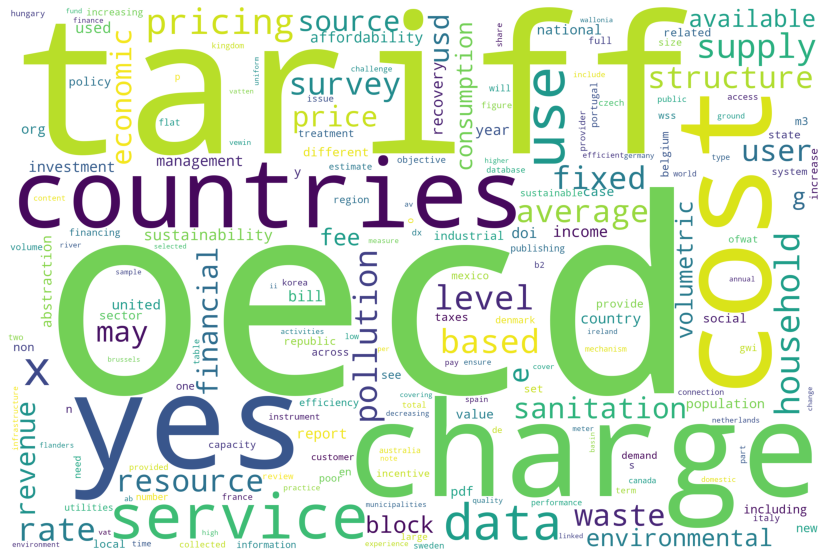


Document number:  19



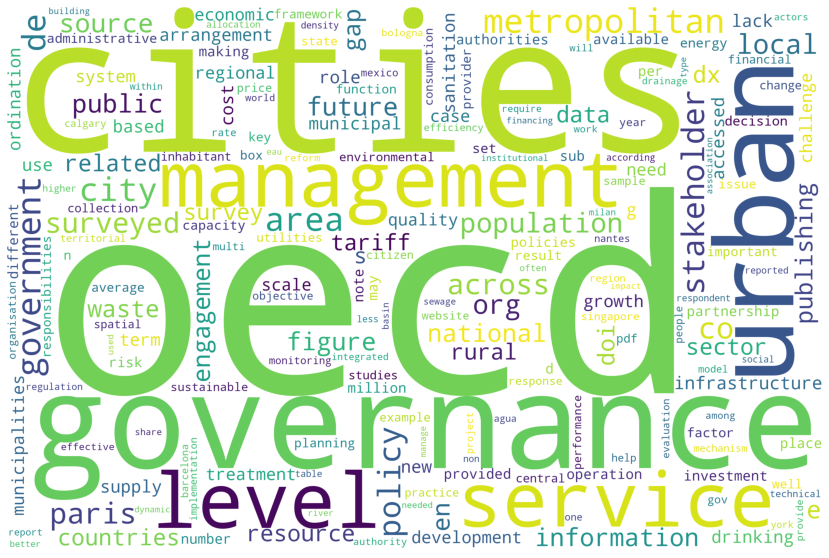


Document number:  18



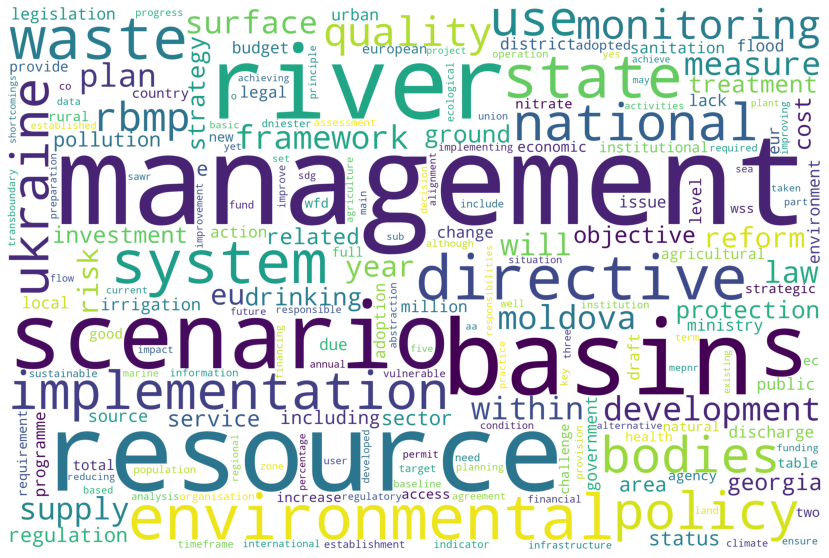


Document number:  24



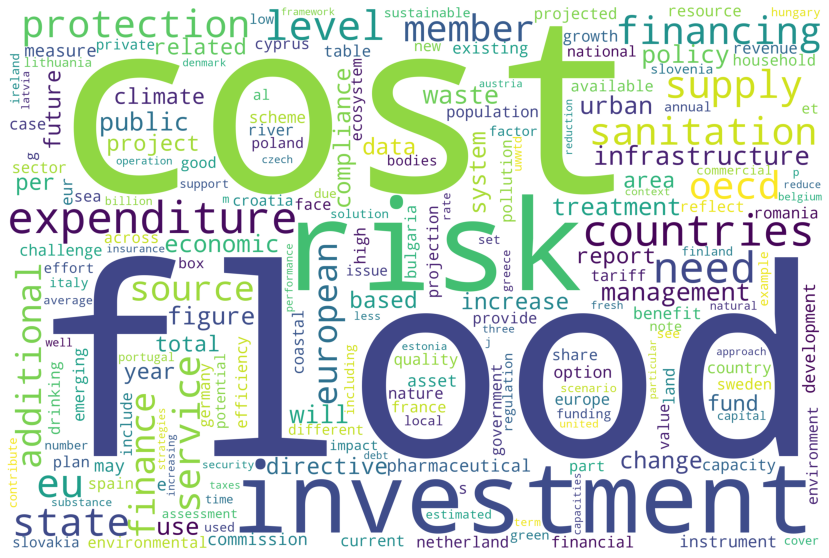


Document number:  30



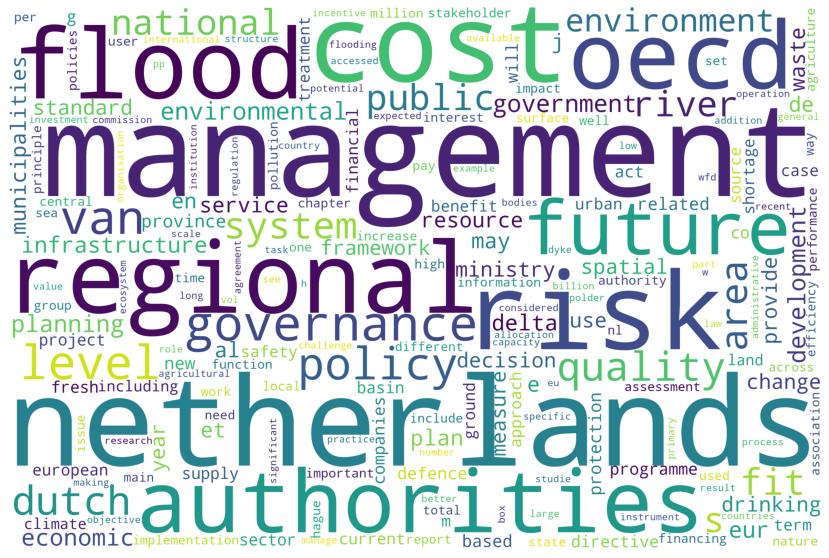

In [8]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, STOPWORDS 

# generate word cloud
# the input of the wordcloud generator
# generate the wordcloud object, set the height and width, set the random_state parameter 
# to ensure reproducibility of results and set the stopwords parameter so that the irrelevant words
# such as pronouns are discarded.
# Water is by far the most frequently occurring word in the corpus so I remove it before generating the clouds
wordclouds = []
for doc in documents:
    wordcloud = WordCloud(width = 3000,
                      height = 2000,
                      random_state=1,
                      background_color='white',
                      collocations=False, stopwords = STOPWORDS).generate(doc.replace("water",""))
    position = val_list.index(doc)
    print("Document number: ", key_list[position])
    entry = {}
    entry["id"] = position
    entry["cloud"] = wordcloud
    wordclouds.append(entry)
    print()
    # text is the input to the generate() method
    #draw the figure
    #Set figure size
    plt.figure(figsize=(15, 10))
    # Display image
    plt.imshow(wordcloud) 
    # No axis 
    plt.axis("off")
    plt.show()
    print()